In [1]:
import geopandas as gpd
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import osmnx as ox
from pyproj import Transformer
import random
import cv2
import os
import requests
import folium
import math
import numpy as np
from shapely.geometry import LineString, MultiLineString, Polygon, MultiPolygon, Point
from shapely.ops import unary_union, polygonize, nearest_points, transform
from PIL import Image
from io import BytesIO
import pyproj
import py360convert
from pathlib import Path 

## Prepare Breña geometries

### Get district boundaries

Obtain Breña polygon

In [2]:
districts = gpd.read_file("../base_data/lima_districts.geojson")
districts = districts.to_crs("EPSG:32718")

districts= districts[["DISTRITO", "geometry"]].copy()
breña= districts[districts["DISTRITO"] == "BREÑA"].copy()

Obtain an offset of Breña polygon (I'll use it to have some tolerance with geometries)

In [3]:
def offset_polygon(gdf, distance=5):
    offset_geoms = []
    for geom in gdf.geometry:
        if isinstance(geom, (Polygon, MultiPolygon)):
            offset = geom.buffer(distance)
            if offset.is_empty:
                continue
            if isinstance(offset, MultiPolygon):
                offset_geoms.extend([poly for poly in offset.geoms if poly.is_valid and not poly.is_empty])
            elif isinstance(offset, Polygon):
                if offset.is_valid:
                    offset_geoms.append(offset)
    return gpd.GeoDataFrame(geometry=offset_geoms, crs=gdf.crs)

In [4]:
breña_offset = offset_polygon(breña, distance=2)

In [5]:
#Obtain the bounding box of the offset polygon
breña_bbox = breña_offset.total_bounds

#Expand the bounding box by a certain offset
offset = 100
bbox_offset = [breña_bbox[0] - offset, breña_bbox[1] - offset, breña_bbox[2] + offset, breña_bbox[3] + offset]
print(bbox_offset)

[np.float64(275526.7223965544), np.float64(8664748.049939053), np.float64(277858.59553128196), np.float64(8667282.200562967)]


### Retrieve street network of Breña

As OSM uses wgs crs, I'll transform all bbox coordinates to WGS

In [6]:
transformer = Transformer.from_crs("EPSG:32718", "EPSG:4326", always_xy=True)
west, south = transformer.transform(bbox_offset[0], bbox_offset[1])
east, north = transformer.transform(bbox_offset[2], bbox_offset[3])
bbox_osm = (west, south, east, north)

In [7]:
# Download street network using bbox
#Use same custom filter that was used in the coverage analysis
custom_filter = (
    '[\"highway\"~\"motorway|trunk|primary|secondary|tertiary|residential|unclassified|living_street|construction\"]'
    '[\"access\"!~\"private\"]' )

#Download the street network
G = ox.graph_from_bbox(bbox_osm,
                       custom_filter=custom_filter,
                       simplify=True)

In [8]:
# Truncate the graph to the polygon of the district

# Get the polygon of Breña in WGS 84
breña_wgs = breña.to_crs('EPSG:4326')
polygon = breña_wgs.geometry.values[0]

# Get the offset polygon of Breña in WGS 84
breña_wgs_offset = breña_offset.to_crs('EPSG:4326')
polygon_offset = breña_wgs_offset.geometry.values[0]

# Truncate the graph to the offset polygon of Breña
G_truncated = ox.truncate.truncate_graph_polygon(G, polygon_offset, truncate_by_edge=True)

In [9]:
output_path = "../base_data/breña_outline_wgs.geojson"
breña_wgs.to_file(output_path, driver="GeoJSON")
print(f"GeoJSON file saved at {output_path}")

GeoJSON file saved at ../base_data/breña_outline_wgs.geojson


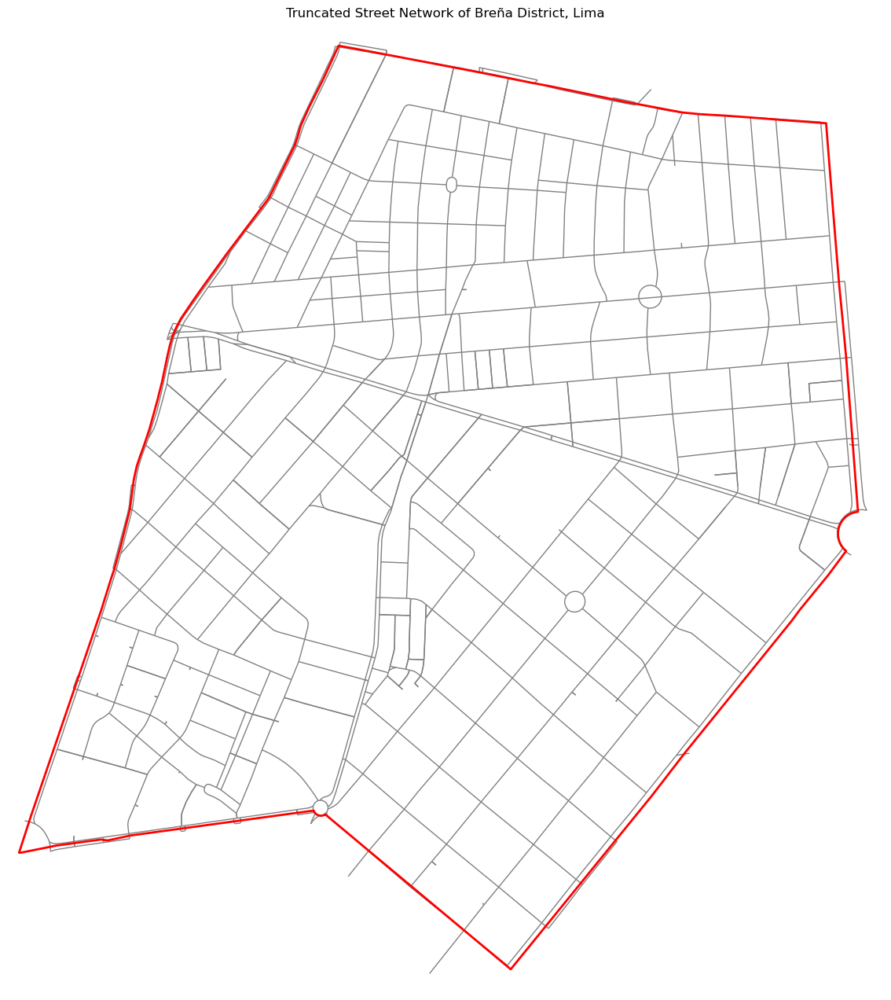

In [10]:
# Plot the truncated graph
fig, ax = plt.subplots(figsize=(24, 16))
ox.plot_graph(G_truncated, 
              ax=ax,
              node_size=0,
              node_color='none',
              edge_color='gray',
              edge_linewidth=1,
              show=False)

# Plot Breña district boundary
breña_wgs.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2)

# Add title and settings
plt.title('Truncated Street Network of Breña District, Lima')
plt.axis('off')
plt.show()

### Simplify graph

In [11]:
#Convert to undirected graph
G_undirected = G_truncated.to_undirected(reciprocal=False)

#Save as GeoDataFrames
nodes, edges = ox.graph_to_gdfs(G_undirected)

Check for duplicated edges between two nodes

In [12]:
#Add columns 'u' and 'v' to edges from its index
edges = edges.reset_index()
edges['u'] = edges['u']
edges['v'] = edges['v']

#Group all rows with the same pair of nodes (u, v) regardless of order
edges['uv'] = edges.apply(lambda row: tuple(sorted((row['u'], row['v']))), axis=1)

#Count occurrences for each pair of nodes (regardless of direction)
counts = edges['uv'].value_counts()

#Show pairs with more than 1 edge (duplicates)
duplicates = counts[counts > 1]

print("Pair of nodes with more than one edge:")
print(duplicates)

Pair of nodes with more than one edge:
Series([], Name: count, dtype: int64)


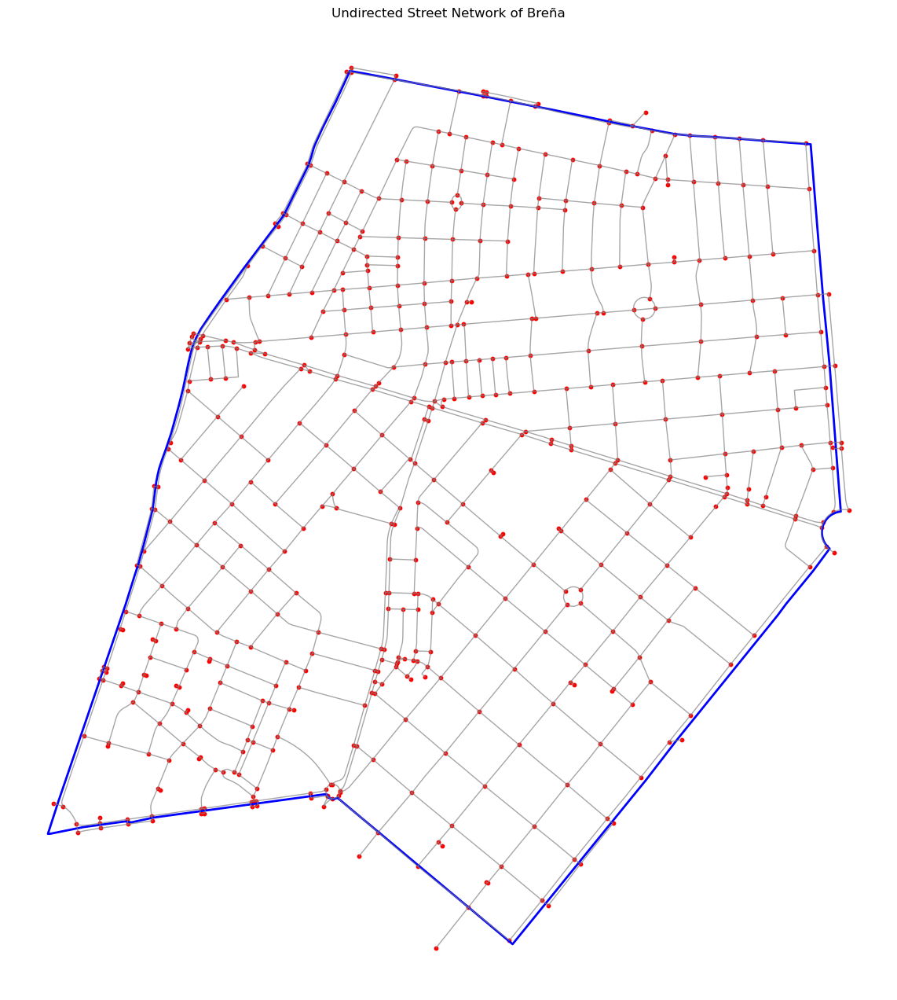

In [13]:
#Plot the undirected graph
fig, ax = plt.subplots(figsize=(24, 16))
edges.plot(ax=ax, edgecolor='gray', linewidth=1, alpha=0.7)
nodes.plot(ax=ax, color='red', markersize=10)
breña_wgs.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=2)
plt.title("Undirected Street Network of Breña")
plt.axis("off")
plt.show()

I won't clean more the street network, as it will only be used to construct blocks. Further edge cleaning will be done on block edges.

### Constructing blocks from osm street network

In [14]:
#Merge all lines into a single geometry
merged_lines = unary_union(edges.geometry)

#Polygonize: convert lines closed in polygons (blocks)
polygons = list(polygonize(merged_lines))

#Convert to GeoDataFrame
blocks = gpd.GeoDataFrame(geometry=polygons, crs=edges.crs)
blocks_proj = blocks.to_crs("EPSG:32718")

In [15]:
#Offset polygons inward by 5 meters (to create a buffer representing the street width)
blocks_proj = offset_polygon(blocks_proj, distance=-5)
blocks = blocks_proj.to_crs("EPSG:4326")

In [16]:
#Project polygon to "EPSG:32718"
polygon_proj = gpd.GeoSeries([polygon], crs="EPSG:4326").to_crs("EPSG:32718").iloc[0]

#Keep only blocks_offset within polygon
blocks_proj = blocks_proj[blocks_proj.geometry.within(polygon_proj)]

In [17]:
#Calculate area in m²
blocks_proj["area_m2"] = blocks_proj.geometry.area

#Filter blocks with area > 50 m²
blocks_proj = blocks_proj[blocks_proj["area_m2"] > 1000]

### Simplify blocks

In [18]:
def count_vertices(polygon):
    return len(polygon.exterior.coords)

In [19]:
#Count vertices
blocks_proj["n_vertices"] = blocks_proj.geometry.apply(count_vertices)

#Simplify geometries
simplified_blocks = blocks_proj.copy()
simplified_blocks["geometry"] = simplified_blocks["geometry"].simplify(tolerance=5, preserve_topology=True)

#Count vertices after simplification
simplified_blocks["n_vertices"] = simplified_blocks.geometry.apply(count_vertices)

In [20]:
total_before = blocks_proj["n_vertices"].sum()
total_after = simplified_blocks["n_vertices"].sum()
print(f"Total vertices before simplify: {total_before}")
print(f"Total vertices after simplify: {total_after}")
print(f"Reduction: {total_before - total_after} vertices ({(1 - total_after/total_before)*100:.2f}%)")

Total vertices before simplify: 4327
Total vertices after simplify: 1311
Reduction: 3016 vertices (69.70%)


In [21]:
blocks_proj = simplified_blocks
blocks_proj["block_id"] = blocks_proj.index

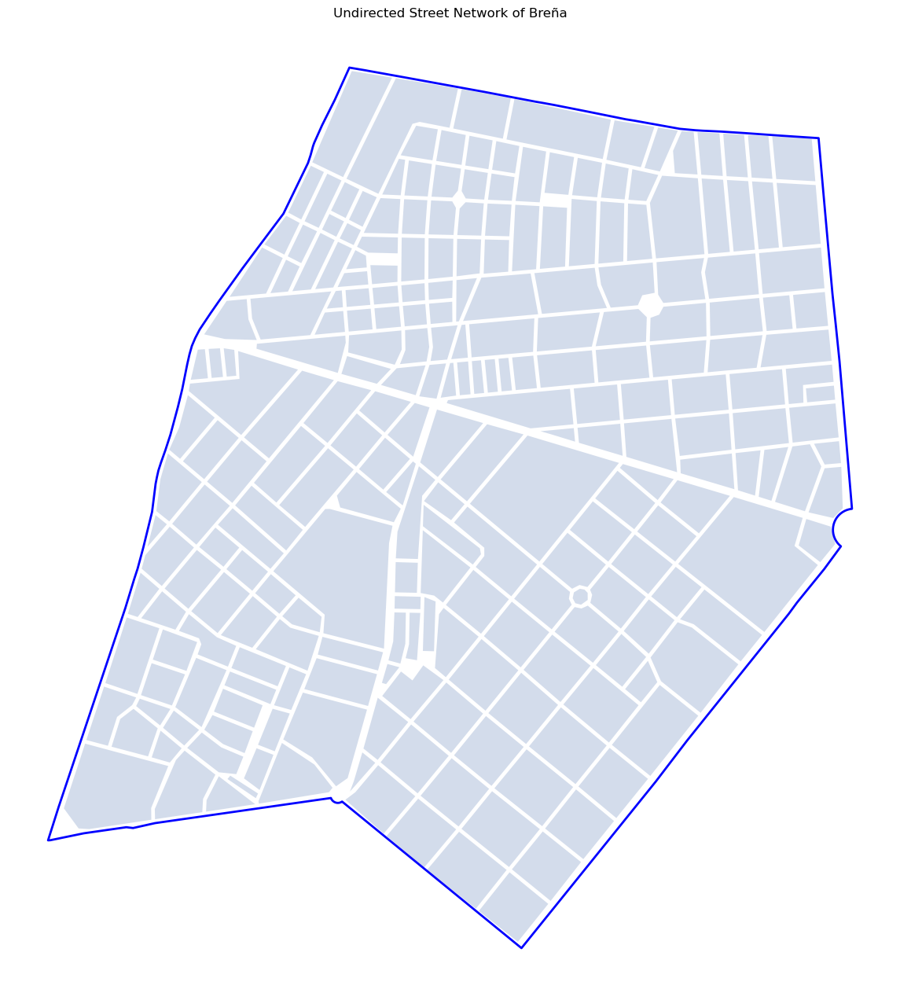

In [22]:
#Plot the graph
fig, ax = plt.subplots(figsize=(24, 16))
blocks_proj.plot(ax=ax, edgecolor='white', linewidth=0.01, alpha=0.7, facecolor='#c1cee3')
breña.plot(ax=ax, facecolor='none', edgecolor='blue', linewidth=2)
plt.title("Undirected Street Network of Breña")
plt.axis("off")
plt.show()

In [23]:
output_path_blocks = "../base_data/breña_blocks_proj.geojson"
blocks_proj.to_file(output_path_blocks, driver="GeoJSON")
print(f"GeoJSON file saved at {output_path_blocks}")

GeoJSON file saved at ../base_data/breña_blocks_proj.geojson


### Map each side of the block (facades)

In [24]:
sides_list = []

for idx, row in blocks_proj.iterrows():
    polygon = row.geometry
    exterior_coords = list(polygon.exterior.coords)
    
    #Convert each pair of consecutive coordinates into a LineString
    for i in range(len(exterior_coords) - 1):
        pt1 = exterior_coords[i]
        pt2 = exterior_coords[i + 1]
        line = LineString([pt1, pt2])
        
        sides_list.append({
            "manzana_id": idx,
            "geometry": line,
            "length": line.length
        })

#Create a GeoDataFrame from the sides list
sides = gpd.GeoDataFrame(sides_list, crs=blocks_proj.crs)

In [25]:
def angle_between_lines(line1, line2):
    #Extract vectors from each line
    x1, y1 = np.array(line1.coords)[-2:]
    x2, y2 = np.array(line2.coords)[:2]
    
    v1 = np.array([x1[0] - y1[0], x1[1] - y1[1]])
    v2 = np.array([y2[0] - x2[0], y2[1] - x2[1]])
    
    #Normalise
    unit_v1 = v1 / np.linalg.norm(v1)
    unit_v2 = v2 / np.linalg.norm(v2)
    
    #Calculate angle
    dot_product = np.clip(np.dot(unit_v1, unit_v2), -1.0, 1.0)
    angle_rad = np.arccos(dot_product)
    angle_deg = np.degrees(angle_rad)
    return angle_deg

In [26]:
def group_lines_by_angle(lines, min_angle=130):
    grouped_lines = []
    current_coords = list(lines[0].coords)

    for i in range(1, len(lines)):
        prev_line = LineString(current_coords)
        next_line = lines[i]

        angle = angle_between_lines(prev_line, next_line)

        if angle >= min_angle:
            #Continue grouping
            current_coords += list(next_line.coords)[1:]  #avoid duplicating point
        else:
            #Close the current group and start a new one
            grouped_lines.append(LineString(current_coords))
            current_coords = list(next_line.coords)

    #Add the last group
    grouped_lines.append(LineString(current_coords))
    return grouped_lines

Define an angle treshold to identify a group of lines as one single side

In [27]:
grouped_sides = []

for manzana_id, group in sides.groupby("manzana_id"):
    ordered_lines = list(group.sort_index().geometry)
    grouped = group_lines_by_angle(ordered_lines, min_angle=140)
    
    for line in grouped:
        grouped_sides.append({
            "block_id": manzana_id,
            "geometry": line,
            "length": line.length
        })

#Create GeoDataFrame
grouped_sides_gdf = gpd.GeoDataFrame(grouped_sides, crs=blocks_proj.crs)

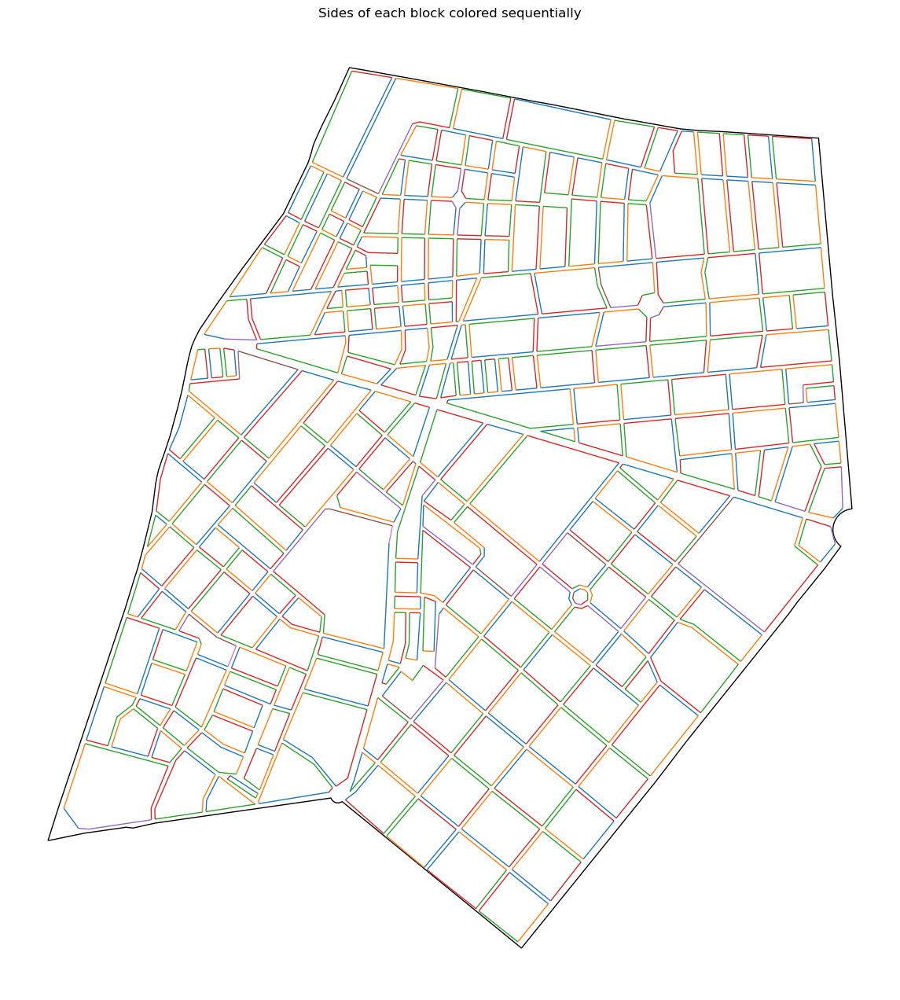

In [28]:
#Generate a list of colors (as many as the maximum number of sides a block has)
max_sides = grouped_sides_gdf.groupby("block_id").size().max()
color_list = list(mcolors.TABLEAU_COLORS.values())

fig, ax = plt.subplots(figsize=(24, 16))

for block_id, group in grouped_sides_gdf.groupby("block_id"):
    for i, row in enumerate(group.itertuples()):
        color = color_list[i % len(color_list)]
        gpd.GeoSeries([row.geometry], crs=grouped_sides_gdf.crs).plot(ax=ax, color=color, linewidth=1)

if 'breña' in locals() and not breña.empty:
    breña.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=1)

plt.title("Sides of each block colored sequentially")
plt.axis("off")
plt.show()

### Assign an edge id for future analysis

In [29]:
#Assign edge numbers for each block
grouped_sides_gdf['edge_num'] = grouped_sides_gdf.groupby('block_id').cumcount() + 1

#Format block id to 4 digits, complete with zeros
grouped_sides_gdf['manzana_str'] = grouped_sides_gdf['block_id'].astype(str).str.zfill(4)

#Format edge number to 3 digits, complete with zeros
grouped_sides_gdf['edge_num_str'] = grouped_sides_gdf['edge_num'].astype(str).str.zfill(3)

#Concatenate to form edge_id
grouped_sides_gdf['edge_id'] = grouped_sides_gdf['manzana_str'] + grouped_sides_gdf['edge_num_str']

#Remove unnecessary columns
grouped_sides_gdf = grouped_sides_gdf.drop(columns=['edge_num', 'manzana_str', 'edge_num_str'])

In [30]:
output_path = "../base_data/final_edges.geojson"

grouped_sides_gdf.to_file(output_path, driver="GeoJSON")
print(f"GeoJSON file saved at {output_path}")

GeoJSON file saved at ../base_data/final_edges.geojson


In [31]:
grouped_sides_gdf.head()

,block_id,geometry,length,edge_id
0,3,"LINESTRING (277732.184 8666014.061, 277707.19 ...",36.009094,0003001
1,3,"LINESTRING (277707.19 8665988.14, 277641.698 8...",67.211507,0003002
2,3,"LINESTRING (277641.698 8666003.249, 277684.263...",124.091153,0003003
3,3,"LINESTRING (277684.263 8666119.812, 277728.342...",44.244162,0003004
4,3,"LINESTRING (277728.342 8666123.632, 277732.184...",109.638713,0003005


## Retrieve Mapillary images

### Define points of retrieval for Mapillary images

In [32]:
#Define a function to get equidistant points along each edge at specified intervals

def get_points_by_length(line, spacing=20):
    length = line.length
    if length < spacing:
        return [line.interpolate(0.5, normalized=True)]  # Punto medio si el lado mide menos que el espaciado
    else:
        num_points = math.ceil(length / spacing)  # Calcular el número de puntos necesarios
        return [line.interpolate(i / num_points, normalized=True) for i in range(1, num_points)]

C:\Users\FIORELLA\AppData\Local\Temp\ipykernel_6560\1256304227.py:25: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend()


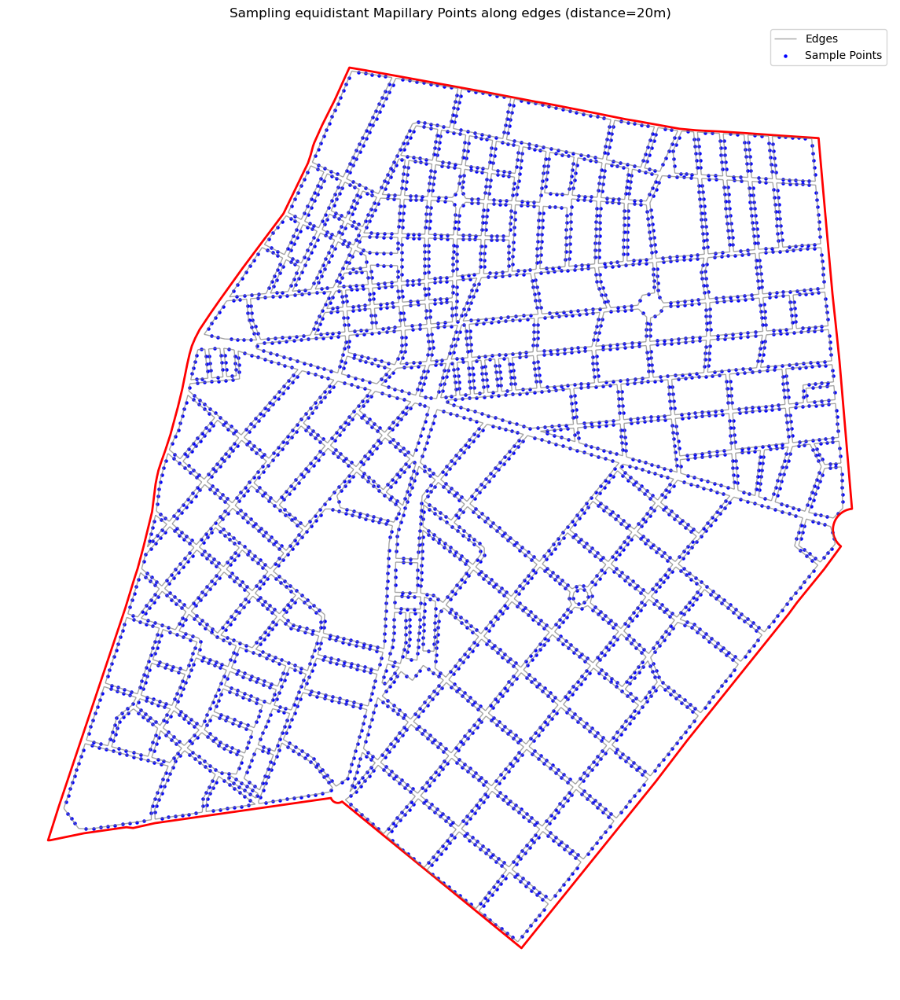

In [33]:
#Get equidistant points
grouped_sides_gdf["points"] = grouped_sides_gdf.geometry.apply(get_points_by_length)

#Create geodataframe for points
points_list = []
for idx, row in grouped_sides_gdf.iterrows():
    for i, point in enumerate(row["points"]):
        points_list.append({
            "edge_id": row["edge_id"],
            "block_id": row["block_id"],
            "point_id": f"{row['edge_id']}_{i+1}",
            "geometry": point
        })

points_gdf = gpd.GeoDataFrame(points_list, crs=grouped_sides_gdf.crs)

#Graph edges with points
fig, ax = plt.subplots(figsize=(24, 16))
if not grouped_sides_gdf.empty:
    grouped_sides_gdf.plot(ax=ax, color="gray", linewidth=1, alpha=0.7, label="Edges")
if not points_gdf.empty:
    points_gdf.plot(ax=ax, color="blue", markersize=5, label="Sample Points")
if 'breña' in locals() and not breña.empty:
    breña.plot(ax=ax, facecolor='none', edgecolor='red', linewidth=2, label="Breña Outline")
plt.legend()
plt.title("Sampling equidistant Mapillary Points along edges (distance=20m)")
plt.axis("off")
plt.show() 

In [34]:
print(f"Number of points: {len(points_gdf)}")

Number of points: 4498


### Test, retrieve closest Mapillary image to my midpoints

In [35]:
gdf_panos = gpd.read_file("../base_data/gdf_panos_lima.geojson")

In [36]:
gdf_panos_breña = gdf_panos[gdf_panos.geometry.intersects(breña_offset.geometry.iloc[0])].copy()
gdf_panos_breña["id"] = pd.to_numeric(gdf_panos_breña["id"], errors='coerce').astype("string")

In [37]:
def find_closest_point(midpoint, points_gdf, max_distance=10):
    #Find the closest point in points_gdf to the Mapillary points
    distances = points_gdf.geometry.distance(midpoint)
    min_dist = distances.min()
    if min_dist <= max_distance:
        closest_idx = distances.idxmin()
        closest_row = points_gdf.loc[closest_idx]
        # Add pano id if found
        return closest_row.id, closest_row.geometry
    else:
        return None, None

#Find closest pano point
closest_ids = []
closest_geoms = []
for idx, row in points_gdf.iterrows():
    midpoint = row.geometry
    pano_id, pano_geom = find_closest_point(midpoint, gdf_panos_breña, max_distance=10)
    closest_ids.append(pano_id)
    closest_geoms.append(pano_geom)

#Add to gdf
points_gdf["closest_pano_id"] = closest_ids
points_gdf["closest_pano_geom"] = closest_geoms

In [38]:
#Calculate distance between sample point and closest Mapillary panorama point
points_gdf['distance'] = points_gdf.apply(lambda row: row['geometry'].distance(row['closest_pano_geom']), axis=1)

In [39]:
points_gdf.head()

,edge_id,block_id,point_id,geometry,closest_pano_id,closest_pano_geom,distance
0,0003001,3,0003001_1,POINT (277719.687 8666001.1),1870951293281181,POINT (277722.5254386077 8665997.652019324),4.466356
1,0003002,3,0003002_1,POINT (277690.817 8665991.917),None,None,NaN
2,0003002,3,0003002_2,POINT (277674.444 8665995.694),None,None,NaN
3,0003002,3,0003002_3,POINT (277658.071 8665999.472),None,None,NaN
4,0003003,3,0003003_1,POINT (277647.779 8666019.901),None,None,NaN


Create a copy of gdf with all geometries transformed to WGS. (Useful to use it with Folium)

In [40]:
#Tranformer to WGS84
project_to_wgs84 = pyproj.Transformer.from_crs(points_gdf.crs, 4326, always_xy=True).transform

#Safely reproject geometries
def safe_reproject(geom):
    if geom is not None and not geom.is_empty:
        return transform(project_to_wgs84, geom)
    return None

points_wgs = points_gdf.copy()
points_wgs = points_gdf.to_crs(epsg=4326)
points_wgs['closest_pano_geom'] = points_gdf['closest_pano_geom'].apply(safe_reproject)

### Evaluate if assignment of closest points is correct

In [41]:
#Filter the 20 farthest midpoints to evaluate if they are correct
farthest_20 = points_wgs.nlargest(20, 'distance')

#Create map
mean_lat = points_wgs['geometry'].y.mean()
mean_lon = points_wgs['geometry'].x.mean()
m = folium.Map(location=[mean_lat, mean_lon], zoom_start=14)

def add_points_to_map(df, color_point, color_pano):
    for _, row in df.iterrows():
        # Punto midpoint (azul)
        folium.CircleMarker(
            location=[row['geometry'].y, row['geometry'].x],
            radius=6,
            color=color_point,
            fill=True,
            fill_color=color_point,
            fill_opacity=0.7,
            popup=f"Edge ID: {row.get('edge_id', 'N/A')}<br>Distance: {row['distance']:.2f} m"
        ).add_to(m)
        
        # Punto pano (rojo)
        folium.CircleMarker(
            location=[row['closest_pano_geom'].y, row['closest_pano_geom'].x],
            radius=6,
            color=color_pano,
            fill=True,
            fill_color=color_pano,
            fill_opacity=0.7,
            popup=f"Closest Pano<br>Distance: {row['distance']:.2f} m"
        ).add_to(m)


#Add 10 farthest points
add_points_to_map(farthest_20, color_point='blue', color_pano='red')

m

Even though they are far, they have been mapped accordingly.

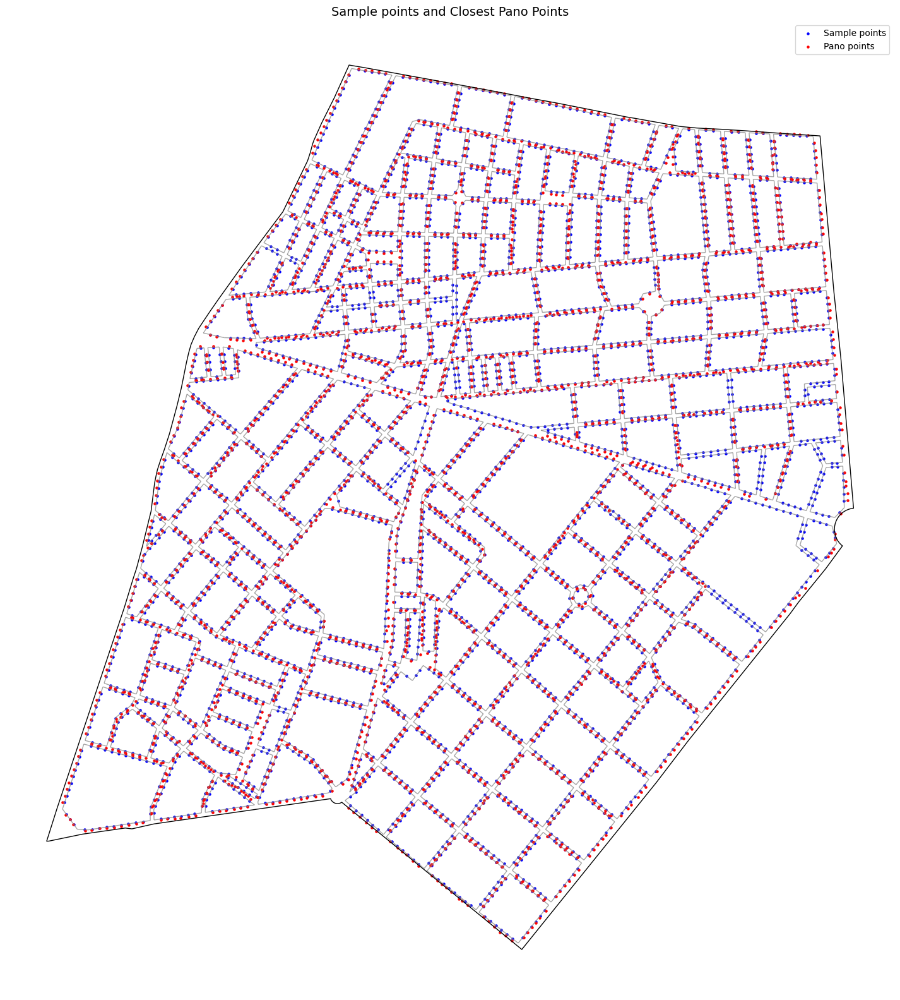

In [42]:
#Create lines between sample point and closest Mapillary point
lines = []
for _, row in points_gdf.iterrows():
    pano_geom = row["closest_pano_geom"]
    if pano_geom:
        line = LineString([row.geometry, pano_geom])
        lines.append(line)

gdf_lines = gpd.GeoDataFrame(geometry=lines, crs=points_gdf.crs)

#Create gdf for matches Mapillary points
pano_points = points_gdf.copy()
pano_points = pano_points.set_geometry("closest_pano_geom")

#Plot
fig, ax = plt.subplots(figsize=(20, 20))
gdf_lines.plot(ax=ax, color="gray", linewidth=1, alpha=0.5)
points_gdf.plot(ax=ax, color="blue", markersize=5, label="Sample points")
pano_points.plot(ax=ax, color="red", markersize=5, label="Pano points")


grouped_sides_gdf.plot(ax=ax, color="gray", linewidth=1, alpha=0.7)
breña.plot(ax=ax, facecolor='none', edgecolor='black', linewidth=1)

ax.set_title("Sample points and Closest Pano Points", fontsize=14)
ax.set_axis_off()
ax.legend()

plt.show()

In [43]:
center = [points_wgs.geometry.y.mean(), points_wgs.geometry.x.mean()]
m = folium.Map(location=center, zoom_start=16, tiles="cartodbpositron")

#Add sample points
for _, row in points_wgs.iterrows():
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=5,
        color='blue',
        fill=True,
        fill_opacity=0.7,
        popup=f"Midpoint {row.name}"
    ).add_to(m)

#Add pano points in red + gray line between both
for _, row in points_wgs.iterrows():
    pano_geom = row["closest_pano_geom"]
    if pano_geom and not pano_geom.is_empty:
        folium.CircleMarker(
            location=[pano_geom.y, pano_geom.x],
            radius=5,
            color='red',
            fill=True,
            fill_opacity=0.7,
            popup=f"Pano ID: {row['closest_pano_id']}"
        ).add_to(m)

        # Línea entre midpoint y pano
        folium.PolyLine(
            locations=[
                [row.geometry.y, row.geometry.x],
                [pano_geom.y, pano_geom.x]
            ],
            color='gray',
            weight=1.5,
            opacity=0.5
        ).add_to(m)

m

In [44]:
#Filter edges with no pano points
no_data = points_gdf[points_gdf['closest_pano_id'].isna()]

In [45]:
#Add edge id to each panorama point
merged = grouped_sides_gdf.merge(
    points_gdf[['edge_id', 'closest_pano_id']],
    on='edge_id',
    how='left'
)

#Filter rows with no closest panorama
no_data = merged[merged['closest_pano_id'].isna()][['edge_id', 'geometry']].copy()

In [46]:
no_data.explore()

After comparing them with Mapillary coverage analysis, this is highly correlated with Mapillary coverage, which implies it's a limitation of the dataset, not the methodology.

In [47]:
#Calculate how many sample points didn't find a Mapillary pano point nearby
num_no_pano = len(no_data)
total_points = len(points_gdf)
percent_no_pano = (num_no_pano / total_points) * 100

print(f"Points without matched pano: {num_no_pano} of {total_points} ({percent_no_pano:.2f}%)")

Points without matched pano: 240 of 4498 (5.34%)


Only a 4.36% of points didn't have a Mapillary panoramic image, which is mainly due to Mapillary lacking coverage in those parts.

### Evaluate whether the point is facing the right side

In [48]:
def evaluate_condition(row, blocks_gdf):
    if pd.isna(row['closest_pano_id']):
        return "no data"

    block = blocks_gdf.loc[blocks_gdf["block_id"] == row["block_id"]]

    #Evaluate if point is within block
    pano_geom = row["closest_pano_geom"]
    block_geom = block.iloc[0].geometry

    if pano_geom.within(block_geom):
        return "within"
    else:
        return "outside"

In [49]:
points_gdf["condition"] = points_gdf.apply(lambda row: evaluate_condition(row, blocks_proj), axis=1)

### Prepare dataset to retrieve mapillary images

Create pano_points dataframe

In [50]:
pano_points = points_gdf.dropna(subset=["closest_pano_geom"]).copy()
pano_points.rename(columns={"geometry": "original_midpoint"}, inplace=True)
pano_points.set_geometry("closest_pano_geom", inplace=True)

pano_points.set_crs(points_gdf.crs, inplace=True)

#Rename columns
pano_points = pano_points.rename(columns={"closest_pano_id": "pano_id"})
pano_points.rename_geometry("geometry", inplace=True)

In [51]:
#Keep only useful columns
edges = grouped_sides_gdf[['edge_id', 'geometry']].rename(columns={'geometry': 'edge_geom'})

#Merge with pano_points on edge_id
pano_points = pano_points.merge(edges, on='edge_id', how='left')

In [52]:
#Project points to closest edge
def get_projected_point(row):
    try:
        if row['edge_geom'] and not row['edge_geom'].is_empty:
            return row['edge_geom'].interpolate(row['edge_geom'].project(row['geometry']))
        else:
            return None
    except:
        return None

#Apply the function
pano_points['projected_point_on_edge'] = pano_points.apply(get_projected_point, axis=1)



In [53]:
ids= points_gdf["closest_pano_id"].dropna().astype("Int64").astype(str).unique().tolist()

Check one row to see everything looks good

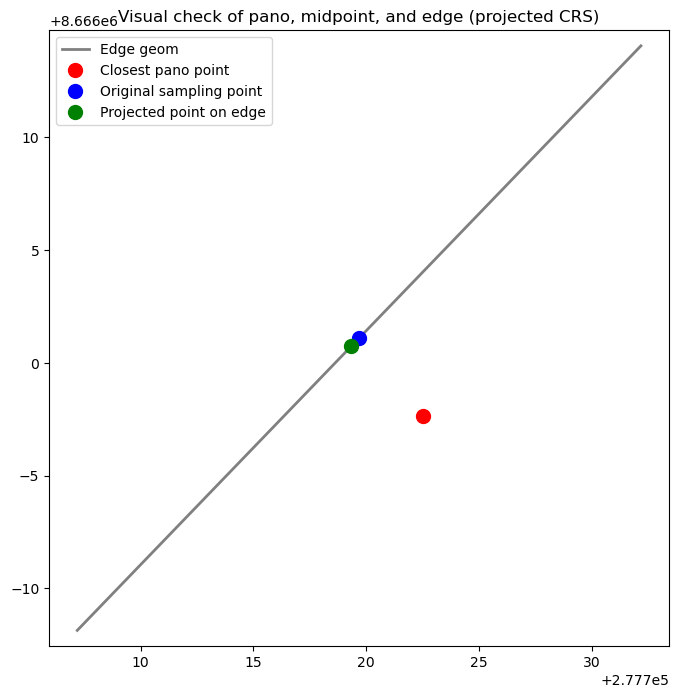

In [54]:
#Test row
row = pano_points.iloc[0]

#PLot
fig, ax = plt.subplots(figsize=(8, 8))

#Add edge_geom (gray line)
if row['edge_geom'] and not row['edge_geom'].is_empty:
    x, y = row['edge_geom'].xy
    ax.plot(x, y, color='gray', linewidth=2, label='Edge geom')

#Add pano point (red)
if row['geometry'] and not row['geometry'].is_empty:
    ax.plot(row['geometry'].x, row['geometry'].y, 'o', color='red', markersize=10, label='Closest pano point')

#Add original midpoint (blue)
if row['original_midpoint'] and not row['original_midpoint'].is_empty:
    ax.plot(row['original_midpoint'].x, row['original_midpoint'].y, 'o', color='blue', markersize=10, label='Original sampling point')

#Add projected point on edge (green)
if row['projected_point_on_edge'] and not row['projected_point_on_edge'].is_empty:
    ax.plot(row['projected_point_on_edge'].x, row['projected_point_on_edge'].y, 'o', color='green', markersize=10, label='Projected point on edge')

#Add title and legend
ax.set_title('Visual check of pano, midpoint, and edge (projected CRS)')
ax.legend()
ax.axis('equal')  # Mantener proporción real en coordenadas
plt.show()


### (SKIP) Query all matched panoramic image urls and features

In [55]:
# MAPILLARY_TOKEN = "insert_your_token_here_or_skip_this_part"

In [56]:
# #Check if all ids are valid
# def chunks(lst, n):
#     for i in range(0, len(lst), n):
#         yield lst[i:i + n]

# all_responses = []

# for batch in chunks(ids, 50): 
#     url = "https://graph.mapillary.com"
#     params = {
#         "ids": ",".join(batch),
#         "access_token": MAPILLARY_TOKEN,
#         "fields": "id,thumb_2048_url,is_pano"
#     }
#     response = requests.get(url, params=params)
#     print(response.status_code)
#     if response.status_code == 200:
#         all_responses.append(response.json())
#     else:
#         print(f"Error con lote {batch}: {response.status_code} {response.text}")

In [57]:
# #Retrieve pano image URLs
# image_urls = []
# for batch_response in all_responses:
#     for img_id, img_info in batch_response.items():
#         if isinstance(img_info, dict):
#             url = img_info.get("thumb_2048_url")
#             is_pano = img_info.get("is_pano", False)

#             if url and is_pano: 
#                 image_urls.append((img_id, url))

In [58]:
# #Convert list of ids and urls to DataFrame
# df = pd.DataFrame(image_urls, columns=["image_id", "url"])
# image_ids = list(df['image_id'])

#### Get computed compass angle for each image

In [59]:
# def get_computed_compass_angle(image_id):
#     url = f'https://graph.mapillary.com/{image_id}?access_token={MAPILLARY_TOKEN}&fields=id,computed_compass_angle'
#     response = requests.get(url)
#     if response.status_code == 200:
#         data = response.json()
#         return data.get("computed_compass_angle")
#     else:
#         print(f"Error with image {image_id}: {response.status_code}")
#         return None


# results = []
# for img_id in image_ids:
#     angle = get_computed_compass_angle(img_id)
#     results.append({"image_id": img_id, "computed_compass_angle": angle})

# #Convert results to DataFrame
# angles_df = pd.DataFrame(results)

In [60]:
# output_path_angles = "../base_data/angles_df.csv"
# angles_df.to_csv(output_path_angles, index=False)
# print(f"DataFrame exported as CSV to {output_path_angles}")

### Calculate angle for image cropping

In [61]:
angles_df = pd.read_csv("../base_data/angles_df.csv", dtype={"image_id": "string"})

In [62]:
final_points = pano_points.merge(angles_df, left_on='pano_id', right_on='image_id', how='left')
final_points = final_points.drop(columns=["image_id"])

In [63]:
def angle_from_north(p1, p2):
    dx = p2.x - p1.x
    dy = p2.y - p1.y
    angle_rad = np.arctan2(dx, dy)
    angle_deg = np.degrees(angle_rad)
    return (angle_deg + 360) % 360

In [64]:
final_points["target_angle"] = final_points.apply(
    lambda row: angle_from_north(row.geometry, row.projected_point_on_edge),
    axis=1
)

In [65]:
def compute_relative_angle(row):
    relative = (row["target_angle"] - row["computed_compass_angle"] + 360) % 360
    if row["condition"] == "within":
        return (relative + 180) % 360
    return relative

final_points["final_camera_angle"] = final_points.apply(compute_relative_angle, axis=1)

In [66]:
print(final_points[final_points["computed_compass_angle"].isna()])

Empty GeoDataFrame
Columns: [edge_id, block_id, point_id, original_midpoint, pano_id, geometry, distance, condition, edge_geom, projected_point_on_edge, computed_compass_angle, target_angle, final_camera_angle]
Index: []


### Check that photo direction is correct

Check that computed_compass_angle is correct by checking it aligns with street direction

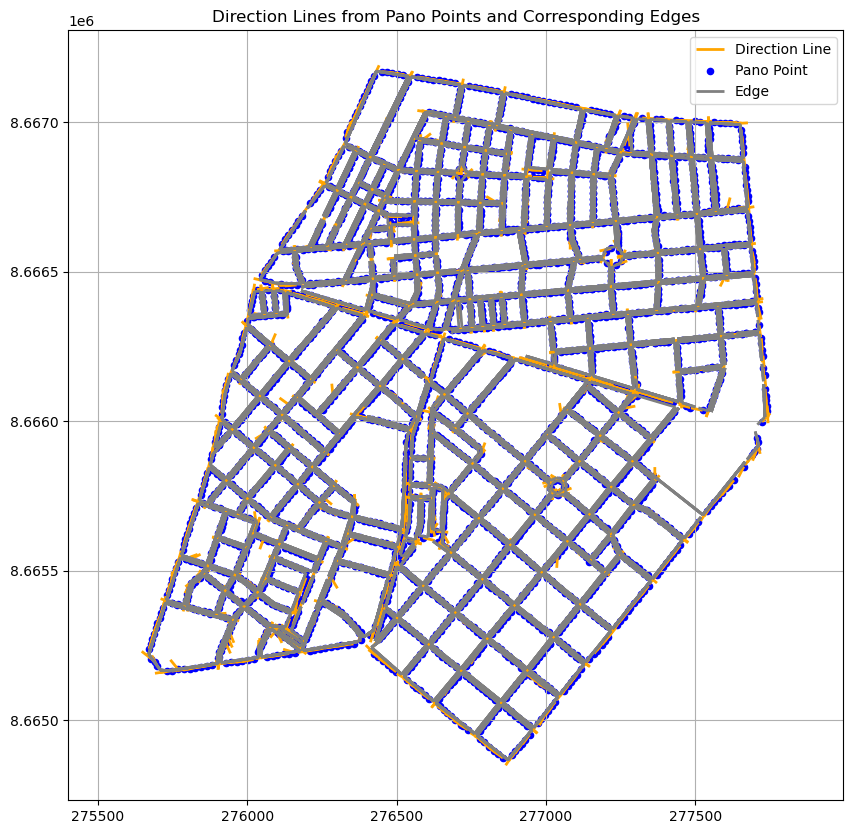

In [67]:
line_length = 40

#Create lines from pano_point with angle final_angle
def create_direction_line(row):
    angle_rad = np.radians(row["computed_compass_angle"]) 
    dx = line_length * np.sin(angle_rad)
    dy = line_length * np.cos(angle_rad)
    x0, y0 = row["geometry"].x, row["geometry"].y
    x1, y1 = x0 + dx, y0 + dy
    return LineString([(x0, y0), (x1, y1)])

#Create column with direction lines
final_points["direction_line"] = final_points.apply(create_direction_line, axis=1)

#Convert to gdf
gdf_lines = gpd.GeoDataFrame(final_points, geometry="direction_line", crs=final_points.crs)
gdf_edges = gpd.GeoDataFrame(final_points, geometry="edge_geom", crs=final_points.crs)

#Plot
fig, ax = plt.subplots(figsize=(10, 10))

gdf_lines.plot(ax=ax, color="orange", linewidth=2, label="Direction Line")
final_points.plot(ax=ax, color="blue", markersize=20, label="Pano Point")
gdf_edges.plot(ax=ax, color="gray", linewidth=2, label="Edge")

ax.legend()
ax.set_title("Direction Lines from Pano Points and Corresponding Edges")
plt.grid(True)
plt.axis("equal")
plt.show()

We can anticipate some issues on photos near the block corners as some original compass angles are deviated probably due to the car turning on the corner. At this point, this errors are negligible.

## Obtain all Mapillary images

This next part is really time intensive and requires a Mapillary token so it has been commented out. Code is still available in case you want to replicate it but results may vary over time. To ensure reproducibility, please use the provided images in '../panos' and '../training_images' for next notebook

### (SKIP) Obtain Mapillary images from all Breña to run inference

#### Request images from Mapillary by id

Extract image urls by id

In [69]:
# #Folder to save images
# output_folder = "../panos/full_panos"
# os.makedirs(output_folder, exist_ok=True)

In [70]:
# #Download full panoramic images by id
# for img_id, url in image_urls:
#     try:
#         r = requests.get(url)
#         if r.status_code == 200:
#             filename = os.path.join(output_folder, f"{img_id}.jpg")
#             with open(filename, "wb") as f:
#                 f.write(r.content)
#             print(f"Image {img_id} downloaded")
#         else:
#             print(f"Error when downloading{img_id}: status {r.status_code}")
#     except Exception as e:
#         print(f"Error when downloading {img_id}: {e}")

#### Crop images facing to each edge

In [71]:
# #Define paths for images
# img_folder = "../panos/full_panos" 
# output_dir = "../panos/cropped_panos" 
# os.makedirs(output_dir, exist_ok=True)

# #Filter points with available images
# available_ids = [f.split('.')[0] for f in os.listdir(img_folder) if f.endswith('.jpg')]
# filtered_points = final_points[final_points["pano_id"].astype(str).isin(available_ids)].copy()

In [72]:
def equirect_to_perspective_full(img, fov, theta_deg, phi_deg=0, roll_deg=180, height=1024, width=2048):
    """
    Converts an equirectangular image to a perspective view with yaw, pitch, and roll control.
    - theta_deg: yaw (horizontal rotation)
    - phi_deg: pitch (vertical tilt)
    - roll_deg: roll (rotation around viewing axis - keeps horizon horizontal)
    """
    equ_h, equ_w = img.shape[:2]

    # Convert degrees to radians
    theta = np.radians(theta_deg)
    phi = np.radians(phi_deg)
    roll = np.radians(roll_deg)

    # Create direction vectors
    x = np.linspace(-np.tan(np.radians(fov / 2)), np.tan(np.radians(fov / 2)), width)
    y = np.linspace(-np.tan(np.radians(fov / 2)) * height / width, np.tan(np.radians(fov / 2)) * height / width, height)
    xv, yv = np.meshgrid(x, y)

    zv = np.ones_like(xv)
    directions = np.stack([xv, yv, zv], axis=-1)
    norm = np.linalg.norm(directions, axis=-1, keepdims=True)
    directions /= norm

    # Rotation matrices
    Ry = np.array([
        [np.cos(theta), 0, np.sin(theta)],
        [0, 1, 0],
        [-np.sin(theta), 0, np.cos(theta)]
    ])

    Rx = np.array([
        [1, 0, 0],
        [0, np.cos(phi), -np.sin(phi)],
        [0, np.sin(phi), np.cos(phi)]
    ])

    Rz = np.array([
        [np.cos(roll), -np.sin(roll), 0],
        [np.sin(roll),  np.cos(roll), 0],
        [0, 0, 1]
    ])

    R = Ry @ Rx @ Rz
    dirs_rotated = directions @ R.T

    #Convert to spherical coords
    lon = np.arctan2(dirs_rotated[..., 0], dirs_rotated[..., 2])
    lat = np.arcsin(dirs_rotated[..., 1])

    #Map to image coords
    u = (lon / np.pi + 1) / 2 * equ_w
    v = (1 - (lat / (np.pi / 2) + 1) / 2) * equ_h

    map_x = u.astype(np.float32)
    map_y = v.astype(np.float32)

    perspective = cv2.remap(img, map_x, map_y, interpolation=cv2.INTER_LINEAR, borderMode=cv2.BORDER_WRAP)
    return perspective

In [73]:
# #Loop to process each point
# for _, row in filtered_points.iterrows():
#     pano_id = str(int(row["pano_id"]))
#     edge_id = str(int(row["edge_id"]))
#     theta = row["final_camera_angle"]

#     img_path = os.path.join(img_folder, f"{pano_id}.jpg")
#     if not os.path.exists(img_path):
#         print(f"No image found for {pano_id}")

#     #Load image
#     img = cv2.imread(str(img_path))
#     if img is None:
#         print(f"Failed to load image {img_path}")
#         continue

#     img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

#     #Convert to perspective
#     persp = equirect_to_perspective_full(img, fov=90, theta_deg=theta, phi_deg=0, roll_deg=180)

#     #Save image
#     out_path = os.path.join(output_dir, f"{edge_id}_{pano_id}.jpg")
#     Image.fromarray(persp).save(out_path)
#     print(f"Saved {out_path}")

### (SKIP) Obtain random images for labeling and training of segmentation model

#### Query Mapillary images

I chose to label 100 images due to limited time. To do so, I opted to download 150 images and then manually filter 100 images that offered greater diversity to the dataset.

In [74]:
# sample_gdf = gdf_panos_breña.sample(n=150, random_state=42).reset_index(drop=True)

In [75]:
# sample_ids = sample_gdf['id'].astype(str).tolist()

In [76]:
# all_responses = []

# for batch in chunks(sample_ids, 10):
#     url = "https://graph.mapillary.com"
#     params = {
#         "ids": ",".join(batch),
#         "access_token": MAPILLARY_TOKEN,
#         "fields": "id,thumb_2048_url,is_pano"
#     }
#     response = requests.get(url, params=params)
#     print(response.status_code)
#     if response.status_code == 200:
#         all_responses.append(response.json())
#     else:
#         print(f"Error with batch {batch}: {response.status_code} {response.text}")

Opted to download images in 2048*1024 to make labelling easier

In [77]:
# #Folder to save images
# output_folder = "../training_images/mapillary/panos"
# os.makedirs(output_folder, exist_ok=True)

# sample_image_urls = []
# for batch_response in all_responses:
#     for img_id, img_info in batch_response.items():
#         if isinstance(img_info, dict):
#             url = img_info.get("thumb_2048_url")
#             is_pano = img_info.get("is_pano", False)

#             if url and is_pano: 
#                 sample_image_urls.append((img_id, url))

In [78]:
# #Download panoramic images by id
# for img_id, url in sample_image_urls:
#     try:
#         r = requests.get(url)
#         if r.status_code == 200:
#             filename = os.path.join(output_folder, f"{img_id}.jpg")
#             with open(filename, "wb") as f:
#                 f.write(r.content)
#             print(f"Image {img_id} downloaded.")
#         else:
#             print(f"Error when downloading {img_id}: status {r.status_code}")
#     except Exception as e:
#         print(f"Error when downloading {img_id}: {e}")

#### Crop to frontal images of edges

In [79]:
# #Create paths
# img_folder = "../training_images/mapillary/panos"
# output_dir = "../training_images/mapillary/cropped_training_panos_"
# output_dir.mkdir(parents=True, exist_ok=True)

# #Filter points with available images
# available_ids = [f.stem for f in img_folder.glob("*.jpg")]
# filtered_points = sample_gdf[sample_gdf["id"].astype(str).isin(available_ids)].copy()

In [80]:
# #Loop to process each point
# for _, row in filtered_points.iterrows():
#     pano_id = str(int(row["id"]))

#     img_path = img_folder / f"{pano_id}.jpg"
#     if not img_path.exists():
#         print(f"No image found for {pano_id}")
#         continue

#     #Open image
#     img = cv2.imread(str(img_path))
#     if img is None:
#         print(f"Failed to load image {img_path}")
#         continue

#     img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

#     #Convert to perspective
#     persp = equirect_to_perspective_full(img, fov=90, theta_deg=270, phi_deg=0, roll_deg=180)

#     #Save image
#     out_path = output_dir / f"{pano_id}.jpg"
#     Image.fromarray(persp).save(out_path)
#     print(f"Saved {out_path}")